In [96]:
import lime
import pickle
import pandas as pd

In [97]:
def load_data(path):
    with open(path, 'rb') as file:
        data = pickle.load(file)
        return data

## Explicabilité BA2

In [98]:
explained_data = pd.read_csv('Step3/explainability_results/lime/BA2/explain_data.csv', index_col=0)

In [99]:
explained_data

,F0semitoneFrom27.5Hz_sma3nz_amean,F0semitoneFrom27.5Hz_sma3nz_stddevNorm,F0semitoneFrom27.5Hz_sma3nz_percentile20.0,F0semitoneFrom27.5Hz_sma3nz_percentile50.0,F0semitoneFrom27.5Hz_sma3nz_percentile80.0,F0semitoneFrom27.5Hz_sma3nz_pctlrange0-2,F0semitoneFrom27.5Hz_sma3nz_meanRisingSlope,F0semitoneFrom27.5Hz_sma3nz_stddevRisingSlope,F0semitoneFrom27.5Hz_sma3nz_meanFallingSlope,F0semitoneFrom27.5Hz_sma3nz_stddevFallingSlope,...,spectralFluxUV_sma3nz_amean,loudnessPeaksPerSec,VoicedSegmentsPerSec,MeanVoicedSegmentLengthSec,StddevVoicedSegmentLengthSec,MeanUnvoicedSegmentLength,StddevUnvoicedSegmentLength,equivalentSoundLevel_dBp,y_true,y_pred
59647,0.664801,-0.694950,0.808209,0.734907,0.546412,-0.478072,-0.659560,-0.623369,-0.212651,-0.338836,...,4.192214,1.884486,1.374851,-0.490126,0.112659,-0.655550,-0.779134,2.107834,0,0
8776,1.157957,-0.354345,1.067966,1.055860,1.167465,0.412685,-0.648087,-0.719990,-0.250759,-0.272699,...,-0.231269,1.458645,0.388951,0.030397,-0.131939,-0.496286,-0.559339,0.052594,0,0
18147,1.268495,4.343296,-2.075276,2.344078,2.301882,9.914468,4.871076,4.455114,3.768176,0.508516,...,1.513842,0.743332,2.535547,-1.607716,-1.176139,-0.116009,-0.247001,0.626206,0,1
243099,-0.748492,-0.148740,-0.744658,-0.658618,-0.625658,0.153933,-0.541138,-0.194645,-0.410122,-0.336179,...,-0.896117,0.416753,-0.599804,0.307282,-0.432937,0.158508,-0.087469,-2.240601,1,1
140858,0.266734,-0.162509,0.365450,0.216141,-0.022706,-0.848718,-0.172149,-0.255623,-0.604724,-0.433517,...,-0.504128,0.344691,-0.624085,0.719556,0.144385,-0.165506,0.802031,0.071794,0,0
73454,1.715862,-0.219110,1.624286,1.948193,1.640702,0.311333,-0.311281,-0.299941,1.181316,1.128214,...,1.193182,0.058215,2.825600,-0.941004,-0.667902,-0.805422,-1.307498,1.086329,0,0
3220,-0.304779,1.082617,-0.943929,0.212666,0.088020,2.261041,-0.396016,-0.526195,-0.047297,-0.479031,...,-0.209445,-0.285362,-0.293650,-1.103157,-0.881544,0.670628,1.411751,-0.414189,0,1
183217,1.854107,-0.590377,1.754481,1.721946,1.798114,0.397016,-0.606901,-0.688556,2.940955,4.105966,...,-0.430427,0.014061,-0.442299,0.183272,0.865341,-0.018105,0.619982,-0.220201,1,0
181035,-1.368779,1.595917,-1.168149,-1.052868,-1.101981,-0.041079,2.062607,1.084101,0.340217,0.158249,...,-0.421407,0.652829,1.814772,-1.043055,-0.561006,-0.350864,-0.165596,-1.014684,1,1
100626,0.002643,0.171689,-0.186386,-0.139863,0.288973,1.083260,-0.670167,-0.789088,-0.163577,0.051450,...,2.090156,1.569272,0.176863,0.359047,0.122580,-0.578832,-1.177357,1.589160,0,0


In [95]:
explained_data.columns

Index(['name', 'F0semitoneFrom27.5Hz_sma3nz_amean',
       'F0semitoneFrom27.5Hz_sma3nz_stddevNorm',
       'F0semitoneFrom27.5Hz_sma3nz_percentile20.0',
       'F0semitoneFrom27.5Hz_sma3nz_percentile50.0',
       'F0semitoneFrom27.5Hz_sma3nz_percentile80.0',
       'F0semitoneFrom27.5Hz_sma3nz_pctlrange0-2',
       'F0semitoneFrom27.5Hz_sma3nz_meanRisingSlope',
       'F0semitoneFrom27.5Hz_sma3nz_stddevRisingSlope',
       'F0semitoneFrom27.5Hz_sma3nz_meanFallingSlope',
       'F0semitoneFrom27.5Hz_sma3nz_stddevFallingSlope', 'loudness_sma3_amean',
       'loudness_sma3_stddevNorm', 'loudness_sma3_percentile20.0',
       'loudness_sma3_percentile50.0', 'loudness_sma3_percentile80.0',
       'loudness_sma3_pctlrange0-2', 'loudness_sma3_meanRisingSlope',
       'loudness_sma3_stddevRisingSlope', 'loudness_sma3_meanFallingSlope',
       'loudness_sma3_stddevFallingSlope', 'spectralFlux_sma3_amean',
       'spectralFlux_sma3_stddevNorm', 'mfcc1_sma3_amean',
       'mfcc1_sma3_stddevNorm',

In [5]:
def get_explained_data(df, pos, features):
    return df.loc[pos, features]

In [6]:
path = 'Step3/explainability_results/lime/BA2/8776/explanation.pkl'
explanation = load_data(path)

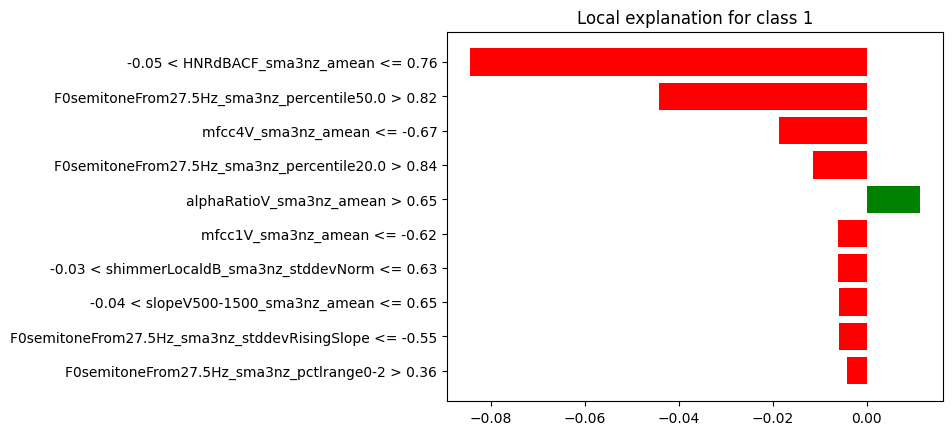

In [7]:
out = explanation.as_pyplot_figure()

In [8]:
df_exp = pd.DataFrame(explanation.as_list(), columns=['feature', 'value'])

In [9]:
df_exp

,feature,value
0,-0.05 < HNRdBACF_sma3nz_amean <= 0.76,-0.084544
1,F0semitoneFrom27.5Hz_sma3nz_percentile50.0 > 0.82,-0.044253
2,mfcc4V_sma3nz_amean <= -0.67,-0.018751
3,F0semitoneFrom27.5Hz_sma3nz_percentile20.0 > 0.84,-0.011515
4,alphaRatioV_sma3nz_amean > 0.65,0.011435
5,mfcc1V_sma3nz_amean <= -0.62,-0.006200
6,-0.03 < shimmerLocaldB_sma3nz_stddevNorm <= 0.63,-0.006183
7,-0.04 < slopeV500-1500_sma3nz_amean <= 0.65,-0.005811
8,F0semitoneFrom27.5Hz_sma3nz_stddevRisingSlope ...,-0.005794
9,F0semitoneFrom27.5Hz_sma3nz_pctlrange0-2 > 0.36,-0.004258


In [10]:
out = explanation.show_in_notebook(show_table=True, show_all=False)

In [11]:
features = [
    'HNRdBACF_sma3nz_amean',
    'F0semitoneFrom27.5Hz_sma3nz_percentile50.0',
    'mfcc4V_sma3nz_amean',
    'F0semitoneFrom27.5Hz_sma3nz_percentile20.0',
    'alphaRatioV_sma3nz_amean',
    'mfcc1V_sma3nz_amean',
    'shimmerLocaldB_sma3nz_stddevNorm',
    'slopeV500-1500_sma3nz_amean',
    'F0semitoneFrom27.5Hz_sma3nz_stddevRisingSlope',
    'F0semitoneFrom27.5Hz_sma3nz_pctlrange0-2',
    'y'
]

In [12]:
get_explained_data(explained_data, 8776, features)

HNRdBACF_sma3nz_amean                            0.150879
F0semitoneFrom27.5Hz_sma3nz_percentile50.0        1.05586
mfcc4V_sma3nz_amean                             -1.004128
F0semitoneFrom27.5Hz_sma3nz_percentile20.0       1.067966
alphaRatioV_sma3nz_amean                         1.440155
mfcc1V_sma3nz_amean                             -1.767457
shimmerLocaldB_sma3nz_stddevNorm                 0.077769
slopeV500-1500_sma3nz_amean                      0.091416
F0semitoneFrom27.5Hz_sma3nz_stddevRisingSlope    -0.71999
F0semitoneFrom27.5Hz_sma3nz_pctlrange0-2         0.412685
y                                                       0
Name: 8776, dtype: object

In [13]:
path = 'Step3/explainability_results/lime/BA2/59647/explanation.pkl'
explanation = load_data(path)

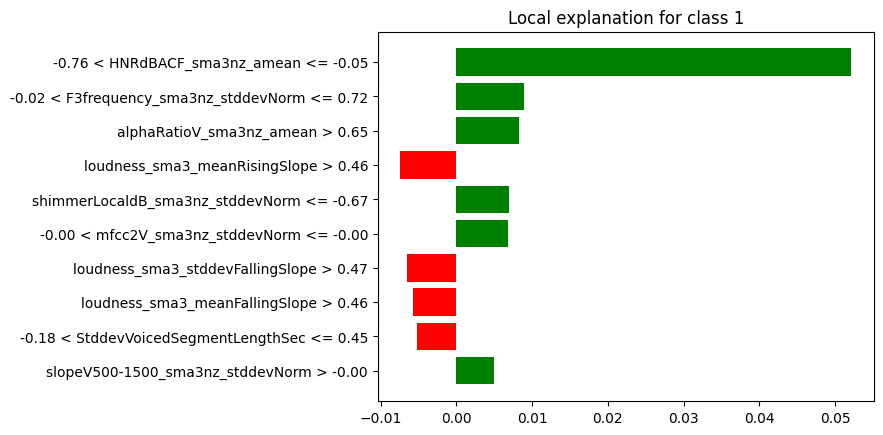

In [14]:
out = explanation.as_pyplot_figure()

In [15]:
df_exp = pd.DataFrame(explanation.as_list(), columns=['feature', 'value'])

In [16]:
df_exp

,feature,value
0,-0.76 < HNRdBACF_sma3nz_amean <= -0.05,0.052144
1,-0.02 < F3frequency_sma3nz_stddevNorm <= 0.72,0.008992
2,alphaRatioV_sma3nz_amean > 0.65,0.008309
3,loudness_sma3_meanRisingSlope > 0.46,-0.007392
4,shimmerLocaldB_sma3nz_stddevNorm <= -0.67,0.006980
5,-0.00 < mfcc2V_sma3nz_stddevNorm <= -0.00,0.006754
6,loudness_sma3_stddevFallingSlope > 0.47,-0.006552
7,loudness_sma3_meanFallingSlope > 0.46,-0.005668
8,-0.18 < StddevVoicedSegmentLengthSec <= 0.45,-0.005144
9,slopeV500-1500_sma3nz_stddevNorm > -0.00,0.004903


In [17]:
out = explanation.show_in_notebook(show_table=True, show_all=False)

In [18]:
features = [
    'HNRdBACF_sma3nz_amean',
    'F3frequency_sma3nz_stddevNorm',
    'alphaRatioV_sma3nz_amean',
    'loudness_sma3_meanRisingSlope',
    'shimmerLocaldB_sma3nz_stddevNorm',
    'mfcc2V_sma3nz_stddevNorm',
    'loudness_sma3_stddevFallingSlope',
    'loudness_sma3_meanFallingSlope',
    'StddevVoicedSegmentLengthSec',
    'slopeV500-1500_sma3nz_stddevNorm',
    'y'
]

In [19]:
get_explained_data(explained_data, 59647, features)

HNRdBACF_sma3nz_amean              -0.223651
F3frequency_sma3nz_stddevNorm       0.078623
alphaRatioV_sma3nz_amean            0.951935
loudness_sma3_meanRisingSlope       3.575561
shimmerLocaldB_sma3nz_stddevNorm    -0.68471
mfcc2V_sma3nz_stddevNorm           -0.001562
loudness_sma3_stddevFallingSlope    3.968513
loudness_sma3_meanFallingSlope      4.385028
StddevVoicedSegmentLengthSec        0.112659
slopeV500-1500_sma3nz_stddevNorm   -0.001814
y                                          0
Name: 59647, dtype: object

## Explicabilité BA3

In [20]:
explained_data = pd.read_csv('Step3/explainability_results/lime/BA3/explain_data.csv', index_col=0)

In [21]:
explained_data

,name,F0semitoneFrom27.5Hz_sma3nz_amean,F0semitoneFrom27.5Hz_sma3nz_stddevNorm,F0semitoneFrom27.5Hz_sma3nz_percentile20.0,F0semitoneFrom27.5Hz_sma3nz_percentile50.0,F0semitoneFrom27.5Hz_sma3nz_percentile80.0,F0semitoneFrom27.5Hz_sma3nz_pctlrange0-2,F0semitoneFrom27.5Hz_sma3nz_meanRisingSlope,F0semitoneFrom27.5Hz_sma3nz_stddevRisingSlope,F0semitoneFrom27.5Hz_sma3nz_meanFallingSlope,...,slopeUV500-1500_sma3nz_amean,spectralFluxUV_sma3nz_amean,loudnessPeaksPerSec,VoicedSegmentsPerSec,MeanVoicedSegmentLengthSec,StddevVoicedSegmentLengthSec,MeanUnvoicedSegmentLength,StddevUnvoicedSegmentLength,equivalentSoundLevel_dBp,y
17527,/local_disk/arges/jduret/corpus/voxceleb2/wav/...,-0.515866,-1.175357,-0.277912,-0.460833,-0.671300,-0.978068,-0.281539,-0.298424,-0.550374,...,-0.554444,-0.151299,-0.424518,-0.596127,0.954361,0.999871,-0.434331,-0.078893,-0.047664,0
40523,/local_disk/arges/jduret/corpus/voxceleb2/wav/...,0.198149,1.507729,-0.378488,0.105493,0.653916,2.318700,0.124463,0.164273,0.067258,...,1.626468,-0.756891,1.441571,0.592266,-0.193708,-0.359722,-0.449284,-0.439505,-1.446820,1


In [22]:
path = 'Step3/explainability_results/lime/BA3/17527/explanation.pkl'
explanation = load_data(path)

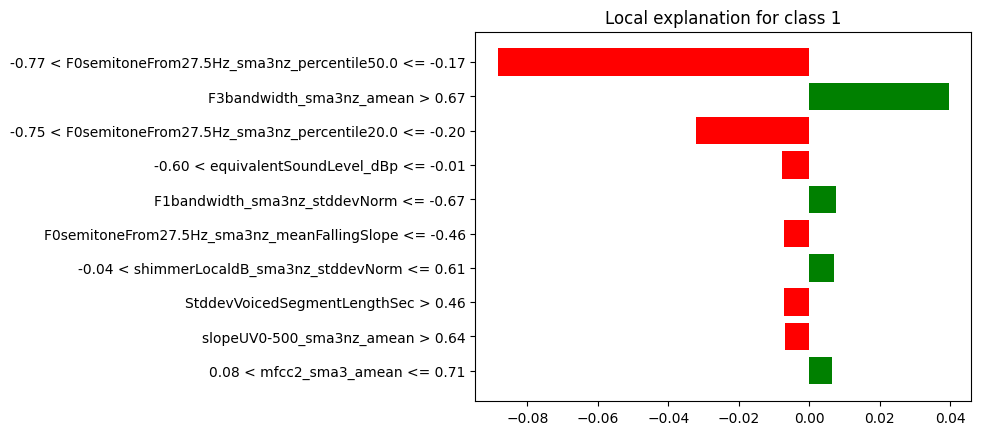

In [23]:
out = explanation.as_pyplot_figure()

In [24]:
df_exp = pd.DataFrame(explanation.as_list(), columns=['feature', 'value'])

In [25]:
df_exp

,feature,value
0,-0.77 < F0semitoneFrom27.5Hz_sma3nz_percentile...,-0.088324
1,F3bandwidth_sma3nz_amean > 0.67,0.039629
2,-0.75 < F0semitoneFrom27.5Hz_sma3nz_percentile...,-0.031980
3,-0.60 < equivalentSoundLevel_dBp <= -0.01,-0.007767
4,F1bandwidth_sma3nz_stddevNorm <= -0.67,0.007674
5,F0semitoneFrom27.5Hz_sma3nz_meanFallingSlope <...,-0.007218
6,-0.04 < shimmerLocaldB_sma3nz_stddevNorm <= 0.61,0.007135
7,StddevVoicedSegmentLengthSec > 0.46,-0.007016
8,slopeUV0-500_sma3nz_amean > 0.64,-0.006941
9,0.08 < mfcc2_sma3_amean <= 0.71,0.006597


In [26]:
out = explanation.show_in_notebook(show_table=True, show_all=False)

In [27]:
explanation.as_list()

[('-0.77 < F0semitoneFrom27.5Hz_sma3nz_percentile50.0 <= -0.17',
  -0.0883244260837274),
 ('F3bandwidth_sma3nz_amean > 0.67', 0.039628636827951785),
 ('-0.75 < F0semitoneFrom27.5Hz_sma3nz_percentile20.0 <= -0.20',
  -0.031980487944665674),
 ('-0.60 < equivalentSoundLevel_dBp <= -0.01', -0.007767317341472099),
 ('F1bandwidth_sma3nz_stddevNorm <= -0.67', 0.00767408683201335),
 ('F0semitoneFrom27.5Hz_sma3nz_meanFallingSlope <= -0.46',
  -0.007217537486199216),
 ('-0.04 < shimmerLocaldB_sma3nz_stddevNorm <= 0.61', 0.007134665850806598),
 ('StddevVoicedSegmentLengthSec > 0.46', -0.007015957497117546),
 ('slopeUV0-500_sma3nz_amean > 0.64', -0.006940998025882554),
 ('0.08 < mfcc2_sma3_amean <= 0.71', 0.0065970384634890375)]

In [28]:
features = [
    'F0semitoneFrom27.5Hz_sma3nz_percentile50.0',
    'F3bandwidth_sma3nz_amean',
    'F0semitoneFrom27.5Hz_sma3nz_percentile20.0',
    'equivalentSoundLevel_dBp',
    'F1bandwidth_sma3nz_stddevNorm',
    'F0semitoneFrom27.5Hz_sma3nz_meanFallingSlope',
    'shimmerLocaldB_sma3nz_stddevNorm',
    'StddevVoicedSegmentLengthSec',
    'slopeUV0-500_sma3nz_amean',
    'mfcc2_sma3_amean',
    'y'
]

In [29]:
get_explained_data(explained_data, 40523, features)

F0semitoneFrom27.5Hz_sma3nz_percentile50.0      0.105493
F3bandwidth_sma3nz_amean                       -0.499417
F0semitoneFrom27.5Hz_sma3nz_percentile20.0     -0.378488
equivalentSoundLevel_dBp                        -1.44682
F1bandwidth_sma3nz_stddevNorm                   0.951477
F0semitoneFrom27.5Hz_sma3nz_meanFallingSlope    0.067258
shimmerLocaldB_sma3nz_stddevNorm               -0.714947
StddevVoicedSegmentLengthSec                   -0.359722
slopeUV0-500_sma3nz_amean                      -0.300544
mfcc2_sma3_amean                               -0.450421
y                                                      1
Name: 40523, dtype: object

## Explicabilité BA4

In [30]:
explained_data = pd.read_csv('Step3/explainability_results/lime/BA4/explain_data.csv', index_col=0)

In [31]:
explained_data

,name,F0semitoneFrom27.5Hz_sma3nz_amean,F0semitoneFrom27.5Hz_sma3nz_stddevNorm,F0semitoneFrom27.5Hz_sma3nz_percentile20.0,F0semitoneFrom27.5Hz_sma3nz_percentile50.0,F0semitoneFrom27.5Hz_sma3nz_percentile80.0,F0semitoneFrom27.5Hz_sma3nz_pctlrange0-2,F0semitoneFrom27.5Hz_sma3nz_meanRisingSlope,F0semitoneFrom27.5Hz_sma3nz_stddevRisingSlope,F0semitoneFrom27.5Hz_sma3nz_meanFallingSlope,...,slopeUV500-1500_sma3nz_amean,spectralFluxUV_sma3nz_amean,loudnessPeaksPerSec,VoicedSegmentsPerSec,MeanVoicedSegmentLengthSec,StddevVoicedSegmentLengthSec,MeanUnvoicedSegmentLength,StddevUnvoicedSegmentLength,equivalentSoundLevel_dBp,y
167907,/local_disk/arges/jduret/corpus/voxceleb2/wav/...,-1.367890,4.051556,-2.335459,-1.245049,-1.21657,1.937846,4.441804,3.014922,4.558980,...,-1.184561,4.589041,0.764142,3.665891,-1.788444,-1.527057,-0.541394,-0.578978,1.760764,1
114573,/local_disk/arges/jduret/corpus/voxceleb2/wav/...,1.280563,-0.942536,1.409791,1.288521,1.02788,-0.523617,-0.645952,-0.703573,0.627795,...,-0.528728,-0.553289,-0.894379,-0.264605,-0.336772,-0.410327,0.292522,0.427113,-0.719005,1


In [32]:
path = 'Step3/explainability_results/lime/BA4/167907/explanation.pkl'
explanation = load_data(path)

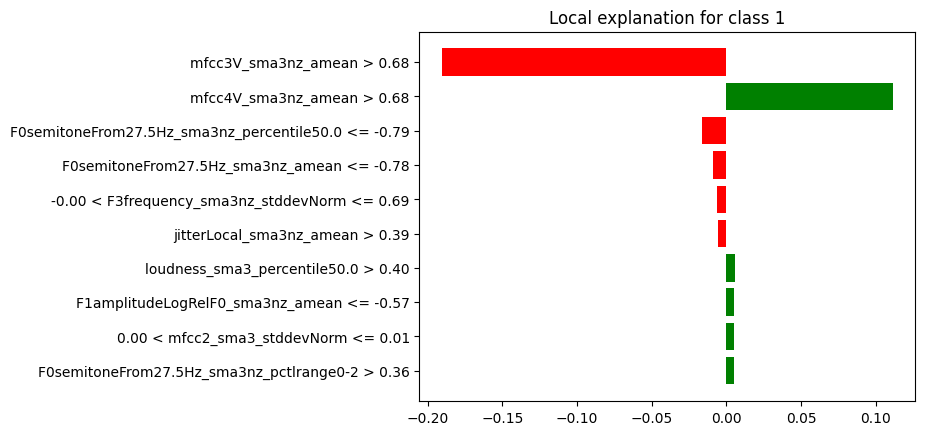

In [33]:
out = explanation.as_pyplot_figure()

In [34]:
df_exp = pd.DataFrame(explanation.as_list(), columns=['feature', 'value'])
df_exp

,feature,value
0,mfcc3V_sma3nz_amean > 0.68,-0.190406
1,mfcc4V_sma3nz_amean > 0.68,0.111613
2,F0semitoneFrom27.5Hz_sma3nz_percentile50.0 <= ...,-0.016465
3,F0semitoneFrom27.5Hz_sma3nz_amean <= -0.78,-0.008678
4,-0.00 < F3frequency_sma3nz_stddevNorm <= 0.69,-0.006081
5,jitterLocal_sma3nz_amean > 0.39,-0.005717
6,loudness_sma3_percentile50.0 > 0.40,0.005705
7,F1amplitudeLogRelF0_sma3nz_amean <= -0.57,0.005134
8,0.00 < mfcc2_sma3_stddevNorm <= 0.01,0.004931
9,F0semitoneFrom27.5Hz_sma3nz_pctlrange0-2 > 0.36,0.004903


In [35]:
out = explanation.show_in_notebook(show_table=True, show_all=False)

In [36]:
explanation.as_list()

[('mfcc3V_sma3nz_amean > 0.68', -0.19040626689877846),
 ('mfcc4V_sma3nz_amean > 0.68', 0.11161278367174697),
 ('F0semitoneFrom27.5Hz_sma3nz_percentile50.0 <= -0.79',
  -0.016464830491822766),
 ('F0semitoneFrom27.5Hz_sma3nz_amean <= -0.78', -0.008677734447048393),
 ('-0.00 < F3frequency_sma3nz_stddevNorm <= 0.69', -0.006080886980788332),
 ('jitterLocal_sma3nz_amean > 0.39', -0.005716675051013691),
 ('loudness_sma3_percentile50.0 > 0.40', 0.005704995883341694),
 ('F1amplitudeLogRelF0_sma3nz_amean <= -0.57', 0.005133780908015172),
 ('0.00 < mfcc2_sma3_stddevNorm <= 0.01', 0.004931109704080372),
 ('F0semitoneFrom27.5Hz_sma3nz_pctlrange0-2 > 0.36', 0.004902744773919992)]

In [37]:
features = [
    'mfcc3V_sma3nz_amean',
    'mfcc4V_sma3nz_amean',
    'F0semitoneFrom27.5Hz_sma3nz_percentile50.0',
    'F0semitoneFrom27.5Hz_sma3nz_amean',
    'F3frequency_sma3nz_stddevNorm',
    'jitterLocal_sma3nz_amean',
    'loudness_sma3_percentile50.0',
    'F1amplitudeLogRelF0_sma3nz_amean',
    'mfcc2_sma3_stddevNorm',
    'F0semitoneFrom27.5Hz_sma3nz_pctlrange0-2',
    'y'
]
get_explained_data(explained_data, 167907, features)

mfcc3V_sma3nz_amean                           1.804903
mfcc4V_sma3nz_amean                           1.552207
F0semitoneFrom27.5Hz_sma3nz_percentile50.0   -1.245049
F0semitoneFrom27.5Hz_sma3nz_amean             -1.36789
F3frequency_sma3nz_stddevNorm                  0.22878
jitterLocal_sma3nz_amean                      3.984616
loudness_sma3_percentile50.0                  1.145447
F1amplitudeLogRelF0_sma3nz_amean             -1.610653
mfcc2_sma3_stddevNorm                         0.004664
F0semitoneFrom27.5Hz_sma3nz_pctlrange0-2      1.937846
y                                                    1
Name: 167907, dtype: object

In [38]:
path = 'Step3/explainability_results/lime/BA4/114573/explanation.pkl'
explanation = load_data(path)


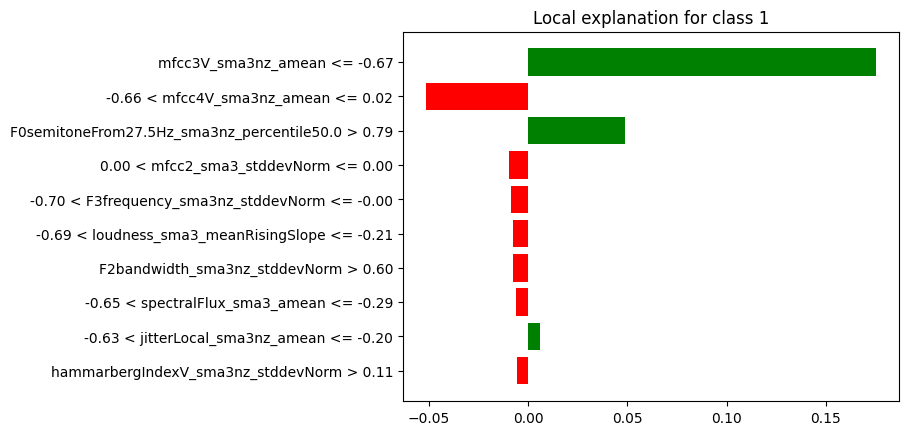

In [39]:
out = explanation.as_pyplot_figure()


In [40]:
df_exp = pd.DataFrame(explanation.as_list(), columns=['feature', 'value'])
df_exp


,feature,value
0,mfcc3V_sma3nz_amean <= -0.67,0.175444
1,-0.66 < mfcc4V_sma3nz_amean <= 0.02,-0.051744
2,F0semitoneFrom27.5Hz_sma3nz_percentile50.0 > 0.79,0.048586
3,0.00 < mfcc2_sma3_stddevNorm <= 0.00,-0.009572
4,-0.70 < F3frequency_sma3nz_stddevNorm <= -0.00,-0.008868
5,-0.69 < loudness_sma3_meanRisingSlope <= -0.21,-0.007833
6,F2bandwidth_sma3nz_stddevNorm > 0.60,-0.007788
7,-0.65 < spectralFlux_sma3_amean <= -0.29,-0.006109
8,-0.63 < jitterLocal_sma3nz_amean <= -0.20,0.005788
9,hammarbergIndexV_sma3nz_stddevNorm > 0.11,-0.005710


In [41]:
out = explanation.show_in_notebook(show_table=True, show_all=False)

In [42]:
explanation.as_list()

[('mfcc3V_sma3nz_amean <= -0.67', 0.1754438969392698),
 ('-0.66 < mfcc4V_sma3nz_amean <= 0.02', -0.05174393950338404),
 ('F0semitoneFrom27.5Hz_sma3nz_percentile50.0 > 0.79', 0.04858601159564454),
 ('0.00 < mfcc2_sma3_stddevNorm <= 0.00', -0.009571538676217167),
 ('-0.70 < F3frequency_sma3nz_stddevNorm <= -0.00', -0.008867891536875637),
 ('-0.69 < loudness_sma3_meanRisingSlope <= -0.21', -0.007832692728996105),
 ('F2bandwidth_sma3nz_stddevNorm > 0.60', -0.00778786537566264),
 ('-0.65 < spectralFlux_sma3_amean <= -0.29', -0.006108571307388963),
 ('-0.63 < jitterLocal_sma3nz_amean <= -0.20', 0.005787610205866721),
 ('hammarbergIndexV_sma3nz_stddevNorm > 0.11', -0.005709615620884101)]

In [43]:
features = [
    'mfcc3V_sma3nz_amean',
    'mfcc4V_sma3nz_amean',
    'F0semitoneFrom27.5Hz_sma3nz_percentile50.0',
    'mfcc2_sma3_stddevNorm',
    'F3frequency_sma3nz_stddevNorm',
    'loudness_sma3_meanRisingSlope',
    'F2bandwidth_sma3nz_stddevNorm',
    'spectralFlux_sma3_amean',
    'jitterLocal_sma3nz_amean',
    'hammarbergIndexV_sma3nz_stddevNorm',
    'y'
]
get_explained_data(explained_data, 114573, features)

mfcc3V_sma3nz_amean                          -1.022297
mfcc4V_sma3nz_amean                          -0.452744
F0semitoneFrom27.5Hz_sma3nz_percentile50.0    1.288521
mfcc2_sma3_stddevNorm                         0.001336
F3frequency_sma3nz_stddevNorm                -0.253101
loudness_sma3_meanRisingSlope                -0.558855
F2bandwidth_sma3nz_stddevNorm                 0.794906
spectralFlux_sma3_amean                      -0.542905
jitterLocal_sma3nz_amean                     -0.274304
hammarbergIndexV_sma3nz_stddevNorm            0.363973
y                                                    1
Name: 114573, dtype: object

## Explicabilité BA5

In [44]:
explained_data = pd.read_csv('Step3/explainability_results/lime/BA5/explain_data.csv', index_col=0)
explained_data


,name,F0semitoneFrom27.5Hz_sma3nz_amean,F0semitoneFrom27.5Hz_sma3nz_stddevNorm,F0semitoneFrom27.5Hz_sma3nz_percentile20.0,F0semitoneFrom27.5Hz_sma3nz_percentile50.0,F0semitoneFrom27.5Hz_sma3nz_percentile80.0,F0semitoneFrom27.5Hz_sma3nz_pctlrange0-2,F0semitoneFrom27.5Hz_sma3nz_meanRisingSlope,F0semitoneFrom27.5Hz_sma3nz_stddevRisingSlope,F0semitoneFrom27.5Hz_sma3nz_meanFallingSlope,...,slopeUV500-1500_sma3nz_amean,spectralFluxUV_sma3nz_amean,loudnessPeaksPerSec,VoicedSegmentsPerSec,MeanVoicedSegmentLengthSec,StddevVoicedSegmentLengthSec,MeanUnvoicedSegmentLength,StddevUnvoicedSegmentLength,equivalentSoundLevel_dBp,y
550495,/local_disk/arges/jduret/corpus/voxceleb2/wav/...,-0.768694,0.387370,-0.673213,-0.758463,-0.730091,-0.207053,0.200876,0.195651,-0.085278,...,-0.013898,-0.544518,1.286451,0.353296,0.068117,0.056701,-0.253061,-0.639220,-0.375800,1
486576,/local_disk/arges/jduret/corpus/voxceleb2/wav/...,-0.105794,-0.542706,-0.025796,-0.196095,-0.143957,-0.263992,-0.622496,-0.451157,0.208757,...,-0.041294,-0.379944,2.195170,1.541910,-0.661954,-0.333113,-0.622545,-0.796645,-0.245572,1


In [45]:
path = 'Step3/explainability_results/lime/BA5/486576/explanation.pkl'
explanation = load_data(path)


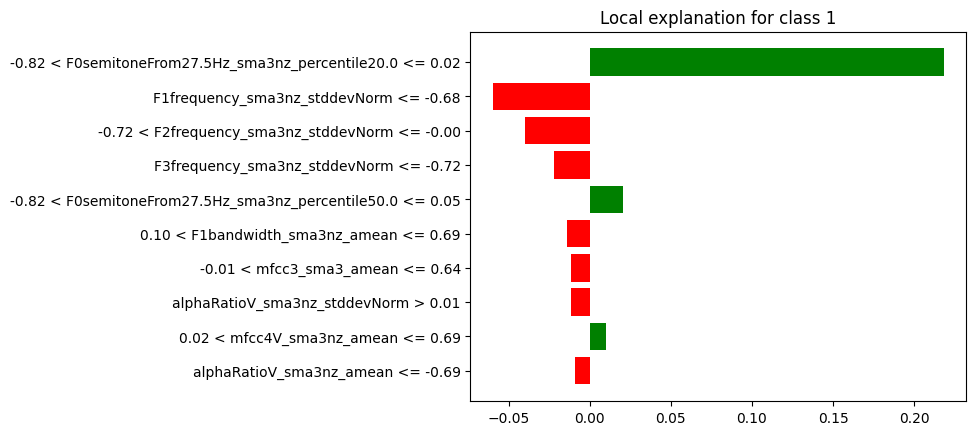

In [46]:
out = explanation.as_pyplot_figure()

In [47]:
df_exp = pd.DataFrame(explanation.as_list(), columns=['feature', 'value'])
df_exp

,feature,value
0,-0.82 < F0semitoneFrom27.5Hz_sma3nz_percentile...,0.218415
1,F1frequency_sma3nz_stddevNorm <= -0.68,-0.059700
2,-0.72 < F2frequency_sma3nz_stddevNorm <= -0.00,-0.039772
3,F3frequency_sma3nz_stddevNorm <= -0.72,-0.022193
4,-0.82 < F0semitoneFrom27.5Hz_sma3nz_percentile...,0.020199
5,0.10 < F1bandwidth_sma3nz_amean <= 0.69,-0.014297
6,-0.01 < mfcc3_sma3_amean <= 0.64,-0.011490
7,alphaRatioV_sma3nz_stddevNorm > 0.01,-0.011416
8,0.02 < mfcc4V_sma3nz_amean <= 0.69,0.009737
9,alphaRatioV_sma3nz_amean <= -0.69,-0.009312


In [48]:
out = explanation.show_in_notebook(show_table=True, show_all=False)

In [49]:
explanation.as_list()

[('-0.82 < F0semitoneFrom27.5Hz_sma3nz_percentile20.0 <= 0.02',
  0.21841458355474674),
 ('F1frequency_sma3nz_stddevNorm <= -0.68', -0.059699669360456634),
 ('-0.72 < F2frequency_sma3nz_stddevNorm <= -0.00', -0.039772300108340625),
 ('F3frequency_sma3nz_stddevNorm <= -0.72', -0.022192757282853096),
 ('-0.82 < F0semitoneFrom27.5Hz_sma3nz_percentile50.0 <= 0.05',
  0.0201992910293956),
 ('0.10 < F1bandwidth_sma3nz_amean <= 0.69', -0.014296547765535466),
 ('-0.01 < mfcc3_sma3_amean <= 0.64', -0.011489909818082306),
 ('alphaRatioV_sma3nz_stddevNorm > 0.01', -0.011416287076186395),
 ('0.02 < mfcc4V_sma3nz_amean <= 0.69', 0.009736856103414519),
 ('alphaRatioV_sma3nz_amean <= -0.69', -0.009312232562671708)]

In [50]:
features = [
    'F0semitoneFrom27.5Hz_sma3nz_percentile20.0',
    'F1frequency_sma3nz_stddevNorm',
    'F2frequency_sma3nz_stddevNorm',
    'F3frequency_sma3nz_stddevNorm',
    'F0semitoneFrom27.5Hz_sma3nz_percentile50.0',
    'F1bandwidth_sma3nz_amean',
    'mfcc3_sma3_amean',
    'alphaRatioV_sma3nz_stddevNorm',
    'mfcc4V_sma3nz_amean',
    'alphaRatioV_sma3nz_amean',
    'y'
]
get_explained_data(explained_data, 486576, features)

F0semitoneFrom27.5Hz_sma3nz_percentile20.0   -0.025796
F1frequency_sma3nz_stddevNorm                -1.096384
F2frequency_sma3nz_stddevNorm                -0.707524
F3frequency_sma3nz_stddevNorm                -1.198616
F0semitoneFrom27.5Hz_sma3nz_percentile50.0   -0.196095
F1bandwidth_sma3nz_amean                      0.653359
mfcc3_sma3_amean                              0.453088
alphaRatioV_sma3nz_stddevNorm                  0.00856
mfcc4V_sma3nz_amean                           0.605191
alphaRatioV_sma3nz_amean                     -1.179475
y                                                    1
Name: 486576, dtype: object

In [51]:
path = 'Step3/explainability_results/lime/BA5/550495/explanation.pkl'
explanation = load_data(path)

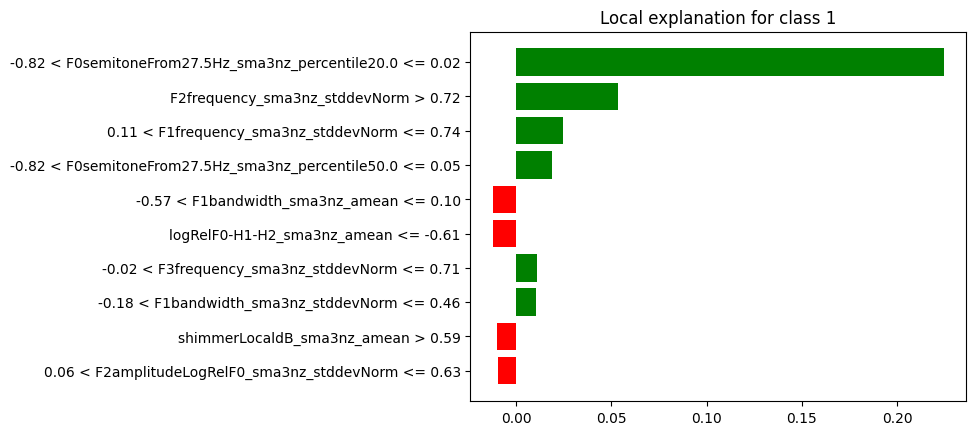

In [52]:
out = explanation.as_pyplot_figure()

In [53]:
df_exp = pd.DataFrame(explanation.as_list(), columns=['feature', 'value'])
df_exp

,feature,value
0,-0.82 < F0semitoneFrom27.5Hz_sma3nz_percentile...,0.224564
1,F2frequency_sma3nz_stddevNorm > 0.72,0.053419
2,0.11 < F1frequency_sma3nz_stddevNorm <= 0.74,0.024382
3,-0.82 < F0semitoneFrom27.5Hz_sma3nz_percentile...,0.018937
4,-0.57 < F1bandwidth_sma3nz_amean <= 0.10,-0.012114
5,logRelF0-H1-H2_sma3nz_amean <= -0.61,-0.012109
6,-0.02 < F3frequency_sma3nz_stddevNorm <= 0.71,0.010982
7,-0.18 < F1bandwidth_sma3nz_stddevNorm <= 0.46,0.010432
8,shimmerLocaldB_sma3nz_amean > 0.59,-0.010126
9,0.06 < F2amplitudeLogRelF0_sma3nz_stddevNorm <...,-0.009332


In [54]:
out = explanation.show_in_notebook(show_table=True, show_all=False)


In [55]:
explanation.as_list()

[('-0.82 < F0semitoneFrom27.5Hz_sma3nz_percentile20.0 <= 0.02',
  0.22456368209995517),
 ('F2frequency_sma3nz_stddevNorm > 0.72', 0.053418896990384844),
 ('0.11 < F1frequency_sma3nz_stddevNorm <= 0.74', 0.024382365517383178),
 ('-0.82 < F0semitoneFrom27.5Hz_sma3nz_percentile50.0 <= 0.05',
  0.01893674933724639),
 ('-0.57 < F1bandwidth_sma3nz_amean <= 0.10', -0.012114087373274983),
 ('logRelF0-H1-H2_sma3nz_amean <= -0.61', -0.012109431708385458),
 ('-0.02 < F3frequency_sma3nz_stddevNorm <= 0.71', 0.010982197372815318),
 ('-0.18 < F1bandwidth_sma3nz_stddevNorm <= 0.46', 0.010431905954470364),
 ('shimmerLocaldB_sma3nz_amean > 0.59', -0.010125667181574233),
 ('0.06 < F2amplitudeLogRelF0_sma3nz_stddevNorm <= 0.63',
  -0.009331600383749899)]

In [56]:
features = [
    'F0semitoneFrom27.5Hz_sma3nz_percentile20.0',
    'F2frequency_sma3nz_stddevNorm',
    'F1frequency_sma3nz_stddevNorm',
    'F0semitoneFrom27.5Hz_sma3nz_percentile50.0',
    'F1bandwidth_sma3nz_amean',
    'logRelF0-H1-H2_sma3nz_amean',
    'F3frequency_sma3nz_stddevNorm',
    'F1bandwidth_sma3nz_stddevNorm',
    'shimmerLocaldB_sma3nz_amean',
    'F2amplitudeLogRelF0_sma3nz_stddevNorm',
    'y'
]
get_explained_data(explained_data, 550495, features)

F0semitoneFrom27.5Hz_sma3nz_percentile20.0   -0.673213
F2frequency_sma3nz_stddevNorm                 1.128741
F1frequency_sma3nz_stddevNorm                 0.699876
F0semitoneFrom27.5Hz_sma3nz_percentile50.0   -0.758463
F1bandwidth_sma3nz_amean                      0.097737
logRelF0-H1-H2_sma3nz_amean                  -1.263198
F3frequency_sma3nz_stddevNorm                 0.651446
F1bandwidth_sma3nz_stddevNorm                 0.068948
shimmerLocaldB_sma3nz_amean                   0.817309
F2amplitudeLogRelF0_sma3nz_stddevNorm         0.214045
y                                                    1
Name: 550495, dtype: object

## Explicabilité BA8

In [57]:
explained_data = pd.read_csv('Step3/explainability_results/lime/BA8/explain_data.csv', index_col=0)
explained_data

,name,F0semitoneFrom27.5Hz_sma3nz_amean,F0semitoneFrom27.5Hz_sma3nz_stddevNorm,F0semitoneFrom27.5Hz_sma3nz_percentile20.0,F0semitoneFrom27.5Hz_sma3nz_percentile50.0,F0semitoneFrom27.5Hz_sma3nz_percentile80.0,F0semitoneFrom27.5Hz_sma3nz_pctlrange0-2,F0semitoneFrom27.5Hz_sma3nz_meanRisingSlope,F0semitoneFrom27.5Hz_sma3nz_stddevRisingSlope,F0semitoneFrom27.5Hz_sma3nz_meanFallingSlope,...,slopeUV500-1500_sma3nz_amean,spectralFluxUV_sma3nz_amean,loudnessPeaksPerSec,VoicedSegmentsPerSec,MeanVoicedSegmentLengthSec,StddevVoicedSegmentLengthSec,MeanUnvoicedSegmentLength,StddevUnvoicedSegmentLength,equivalentSoundLevel_dBp,y
296569,/local_disk/arges/jduret/corpus/voxceleb2/wav/...,2.359370,-0.124037,2.433845,2.52627,2.275782,0.100782,-0.448044,-0.585646,1.392456,...,1.175304,-0.367600,0.040676,0.833192,-1.127265,-1.055489,0.193567,0.599397,-1.097653,1
56545,/local_disk/arges/jduret/corpus/voxceleb2/wav/...,1.192476,-0.140657,1.118817,1.15932,1.050052,0.054970,-0.469543,-0.619224,-0.319743,...,0.599521,0.201124,1.329783,1.222961,-0.521500,-0.240139,-0.636149,-0.078006,0.615251,0


In [58]:
path = 'Step3/explainability_results/lime/BA8/56545/explanation.pkl'
explanation = load_data(path)

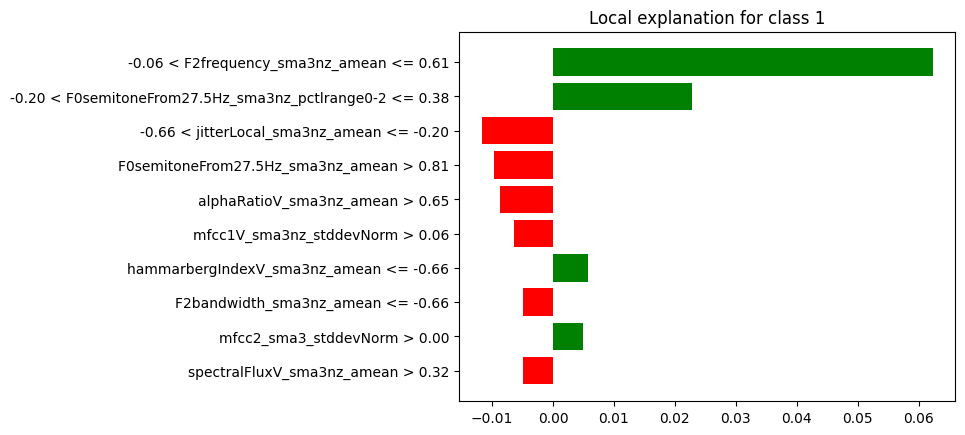

In [59]:
out = explanation.as_pyplot_figure()

In [60]:
df_exp = pd.DataFrame(explanation.as_list(), columns=['feature', 'value'])
df_exp

,feature,value
0,-0.06 < F2frequency_sma3nz_amean <= 0.61,0.062269
1,-0.20 < F0semitoneFrom27.5Hz_sma3nz_pctlrange0...,0.022819
2,-0.66 < jitterLocal_sma3nz_amean <= -0.20,-0.011707
3,F0semitoneFrom27.5Hz_sma3nz_amean > 0.81,-0.009737
4,alphaRatioV_sma3nz_amean > 0.65,-0.008641
5,mfcc1V_sma3nz_stddevNorm > 0.06,-0.006323
6,hammarbergIndexV_sma3nz_amean <= -0.66,0.005777
7,F2bandwidth_sma3nz_amean <= -0.66,-0.004951
8,mfcc2_sma3_stddevNorm > 0.00,0.004946
9,spectralFluxV_sma3nz_amean > 0.32,-0.004907


In [61]:
out = explanation.show_in_notebook(show_table=True, show_all=False)

In [62]:
explanation.as_list()

[('-0.06 < F2frequency_sma3nz_amean <= 0.61', 0.06226891199679392),
 ('-0.20 < F0semitoneFrom27.5Hz_sma3nz_pctlrange0-2 <= 0.38',
  0.022818627496590464),
 ('-0.66 < jitterLocal_sma3nz_amean <= -0.20', -0.011706537362328248),
 ('F0semitoneFrom27.5Hz_sma3nz_amean > 0.81', -0.009736589946931164),
 ('alphaRatioV_sma3nz_amean > 0.65', -0.008640879872492145),
 ('mfcc1V_sma3nz_stddevNorm > 0.06', -0.006323347289574161),
 ('hammarbergIndexV_sma3nz_amean <= -0.66', 0.0057772454781671485),
 ('F2bandwidth_sma3nz_amean <= -0.66', -0.00495057856760379),
 ('mfcc2_sma3_stddevNorm > 0.00', 0.004946142569186653),
 ('spectralFluxV_sma3nz_amean > 0.32', -0.004907478222477538)]

In [63]:
features = [
    'F2frequency_sma3nz_amean',
    'F0semitoneFrom27.5Hz_sma3nz_pctlrange0-2',
    'jitterLocal_sma3nz_amean',
    'F0semitoneFrom27.5Hz_sma3nz_amean',
    'alphaRatioV_sma3nz_amean',
    'mfcc1V_sma3nz_stddevNorm',
    'hammarbergIndexV_sma3nz_amean',
    'F2bandwidth_sma3nz_amean',
    'mfcc2_sma3_stddevNorm',
    'spectralFluxV_sma3nz_amean',
    'y'
]
get_explained_data(explained_data, 56545, features)

F2frequency_sma3nz_amean                    0.331064
F0semitoneFrom27.5Hz_sma3nz_pctlrange0-2     0.05497
jitterLocal_sma3nz_amean                   -0.342378
F0semitoneFrom27.5Hz_sma3nz_amean           1.192476
alphaRatioV_sma3nz_amean                    0.905583
mfcc1V_sma3nz_stddevNorm                    0.554587
hammarbergIndexV_sma3nz_amean              -1.128776
F2bandwidth_sma3nz_amean                   -1.309439
mfcc2_sma3_stddevNorm                       0.004361
spectralFluxV_sma3nz_amean                  0.361566
y                                                  0
Name: 56545, dtype: object

In [64]:
path = 'Step3/explainability_results/lime/BA8/296569/explanation.pkl'
explanation = load_data(path)

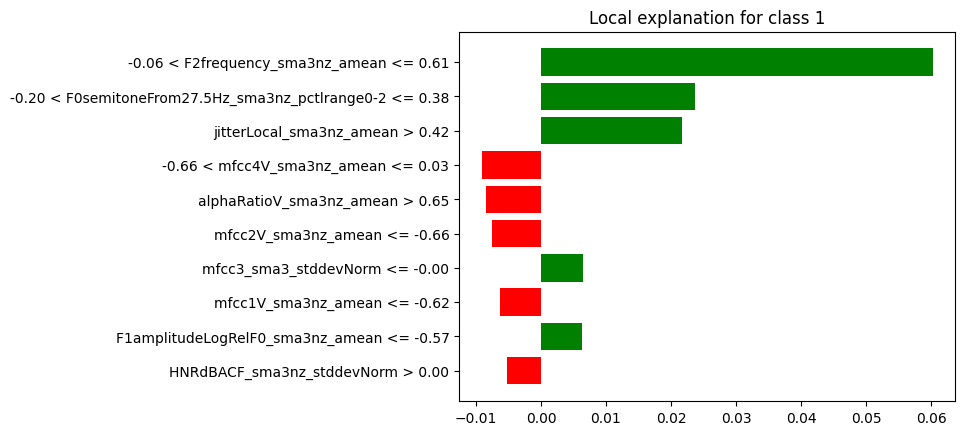

In [65]:
out = explanation.as_pyplot_figure()

In [66]:
df_exp = pd.DataFrame(explanation.as_list(), columns=['feature', 'value'])
df_exp

,feature,value
0,-0.06 < F2frequency_sma3nz_amean <= 0.61,0.060234
1,-0.20 < F0semitoneFrom27.5Hz_sma3nz_pctlrange0...,0.023745
2,jitterLocal_sma3nz_amean > 0.42,0.021685
3,-0.66 < mfcc4V_sma3nz_amean <= 0.03,-0.009124
4,alphaRatioV_sma3nz_amean > 0.65,-0.008525
5,mfcc2V_sma3nz_amean <= -0.66,-0.007530
6,mfcc3_sma3_stddevNorm <= -0.00,0.006395
7,mfcc1V_sma3nz_amean <= -0.62,-0.006311
8,F1amplitudeLogRelF0_sma3nz_amean <= -0.57,0.006255
9,HNRdBACF_sma3nz_stddevNorm > 0.00,-0.005260


In [67]:
out = explanation.show_in_notebook(show_table=True, show_all=False)

In [68]:
explanation.as_list()

[('-0.06 < F2frequency_sma3nz_amean <= 0.61', 0.06023432880760313),
 ('-0.20 < F0semitoneFrom27.5Hz_sma3nz_pctlrange0-2 <= 0.38',
  0.02374542683661128),
 ('jitterLocal_sma3nz_amean > 0.42', 0.021684625482310874),
 ('-0.66 < mfcc4V_sma3nz_amean <= 0.03', -0.00912358560677729),
 ('alphaRatioV_sma3nz_amean > 0.65', -0.008524680649403042),
 ('mfcc2V_sma3nz_amean <= -0.66', -0.0075303230751456954),
 ('mfcc3_sma3_stddevNorm <= -0.00', 0.006395340017958396),
 ('mfcc1V_sma3nz_amean <= -0.62', -0.006310999998994793),
 ('F1amplitudeLogRelF0_sma3nz_amean <= -0.57', 0.006255371550652767),
 ('HNRdBACF_sma3nz_stddevNorm > 0.00', -0.005259962544654541)]

In [69]:
features = [
    'F2frequency_sma3nz_amean',
    'F0semitoneFrom27.5Hz_sma3nz_pctlrange0-2',
    'jitterLocal_sma3nz_amean',
    'mfcc4V_sma3nz_amean',
    'alphaRatioV_sma3nz_amean',
    'mfcc2V_sma3nz_amean',
    'mfcc3_sma3_stddevNorm',
    'mfcc1V_sma3nz_amean',
    'F1amplitudeLogRelF0_sma3nz_amean',
    'HNRdBACF_sma3nz_stddevNorm',
    'y'
]
get_explained_data(explained_data, 296569, features)

F2frequency_sma3nz_amean                    0.249693
F0semitoneFrom27.5Hz_sma3nz_pctlrange0-2    0.100782
jitterLocal_sma3nz_amean                    1.135441
mfcc4V_sma3nz_amean                        -0.610242
alphaRatioV_sma3nz_amean                    2.153568
mfcc2V_sma3nz_amean                        -1.301974
mfcc3_sma3_stddevNorm                      -0.004972
mfcc1V_sma3nz_amean                         -2.59594
F1amplitudeLogRelF0_sma3nz_amean           -1.910027
HNRdBACF_sma3nz_stddevNorm                  0.007402
y                                                  1
Name: 296569, dtype: object

## Explicabilité BA9

In [70]:
explained_data = pd.read_csv('Step3/explainability_results/lime/BA9/explain_data.csv', index_col=0)
explained_data

,name,F0semitoneFrom27.5Hz_sma3nz_amean,F0semitoneFrom27.5Hz_sma3nz_stddevNorm,F0semitoneFrom27.5Hz_sma3nz_percentile20.0,F0semitoneFrom27.5Hz_sma3nz_percentile50.0,F0semitoneFrom27.5Hz_sma3nz_percentile80.0,F0semitoneFrom27.5Hz_sma3nz_pctlrange0-2,F0semitoneFrom27.5Hz_sma3nz_meanRisingSlope,F0semitoneFrom27.5Hz_sma3nz_stddevRisingSlope,F0semitoneFrom27.5Hz_sma3nz_meanFallingSlope,...,slopeUV500-1500_sma3nz_amean,spectralFluxUV_sma3nz_amean,loudnessPeaksPerSec,VoicedSegmentsPerSec,MeanVoicedSegmentLengthSec,StddevVoicedSegmentLengthSec,MeanUnvoicedSegmentLength,StddevUnvoicedSegmentLength,equivalentSoundLevel_dBp,y
203077,/local_disk/arges/jduret/corpus/voxceleb2/wav/...,-0.365997,0.322981,-0.299467,-0.280530,-0.436722,-0.356998,0.251905,0.121468,-0.107475,...,-0.492675,-0.490053,0.120871,-0.118923,-0.098502,-0.011161,-0.069506,-0.418679,-0.295799,0
85514,/local_disk/arges/jduret/corpus/voxceleb2/wav/...,-0.996231,-1.438996,-0.663449,-0.945609,-1.193655,-1.300734,-0.376030,-0.355554,-0.502003,...,0.938765,-0.510795,0.216857,-0.716277,0.795810,0.199947,0.077517,0.355309,-0.284300,0


In [71]:
path = 'Step3/explainability_results/lime/BA9/85514/explanation.pkl'
explanation = load_data(path)

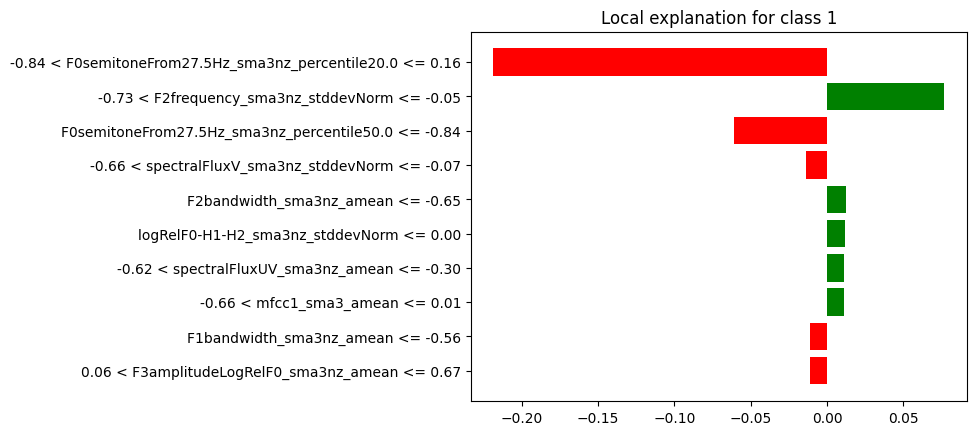

In [72]:
out = explanation.as_pyplot_figure()

In [73]:
df_exp = pd.DataFrame(explanation.as_list(), columns=['feature', 'value'])
df_exp

,feature,value
0,-0.84 < F0semitoneFrom27.5Hz_sma3nz_percentile...,-0.218686
1,-0.73 < F2frequency_sma3nz_stddevNorm <= -0.05,0.076825
2,F0semitoneFrom27.5Hz_sma3nz_percentile50.0 <= ...,-0.060908
3,-0.66 < spectralFluxV_sma3nz_stddevNorm <= -0.07,-0.013585
4,F2bandwidth_sma3nz_amean <= -0.65,0.012548
5,logRelF0-H1-H2_sma3nz_stddevNorm <= 0.00,0.011528
6,-0.62 < spectralFluxUV_sma3nz_amean <= -0.30,0.011474
7,-0.66 < mfcc1_sma3_amean <= 0.01,0.011400
8,F1bandwidth_sma3nz_amean <= -0.56,-0.011358
9,0.06 < F3amplitudeLogRelF0_sma3nz_amean <= 0.67,-0.010859


In [74]:
out = explanation.show_in_notebook(show_table=True, show_all=False)

In [75]:
explanation.as_list()

[('-0.84 < F0semitoneFrom27.5Hz_sma3nz_percentile20.0 <= 0.16',
  -0.2186861576845534),
 ('-0.73 < F2frequency_sma3nz_stddevNorm <= -0.05', 0.07682509549219464),
 ('F0semitoneFrom27.5Hz_sma3nz_percentile50.0 <= -0.84',
  -0.060908387603359974),
 ('-0.66 < spectralFluxV_sma3nz_stddevNorm <= -0.07', -0.013585039304200007),
 ('F2bandwidth_sma3nz_amean <= -0.65', 0.012547640157205994),
 ('logRelF0-H1-H2_sma3nz_stddevNorm <= 0.00', 0.011527763311683838),
 ('-0.62 < spectralFluxUV_sma3nz_amean <= -0.30', 0.011474076905844371),
 ('-0.66 < mfcc1_sma3_amean <= 0.01', 0.01139963881962431),
 ('F1bandwidth_sma3nz_amean <= -0.56', -0.01135793080974449),
 ('0.06 < F3amplitudeLogRelF0_sma3nz_amean <= 0.67', -0.01085914715208393)]

In [76]:
features = [
    'F0semitoneFrom27.5Hz_sma3nz_percentile20.0',
    'F2frequency_sma3nz_stddevNorm',
    'F0semitoneFrom27.5Hz_sma3nz_percentile50.0',
    'spectralFluxV_sma3nz_stddevNorm',
    'F2bandwidth_sma3nz_amean',
    'logRelF0-H1-H2_sma3nz_stddevNorm',
    'spectralFluxUV_sma3nz_amean',
    'mfcc1_sma3_amean',
    'F1bandwidth_sma3nz_amean',
    'F3amplitudeLogRelF0_sma3nz_amean',
    'y'
]
get_explained_data(explained_data, 85514, features)

F0semitoneFrom27.5Hz_sma3nz_percentile20.0   -0.663449
F2frequency_sma3nz_stddevNorm                -0.184694
F0semitoneFrom27.5Hz_sma3nz_percentile50.0   -0.945609
spectralFluxV_sma3nz_stddevNorm              -0.105274
F2bandwidth_sma3nz_amean                      -0.83063
logRelF0-H1-H2_sma3nz_stddevNorm              0.001648
spectralFluxUV_sma3nz_amean                  -0.510795
mfcc1_sma3_amean                             -0.285956
F1bandwidth_sma3nz_amean                     -0.701656
F3amplitudeLogRelF0_sma3nz_amean              0.417069
y                                                    0
Name: 85514, dtype: object

In [77]:
path = 'Step3/explainability_results/lime/BA9/203077/explanation.pkl'
explanation = load_data(path)

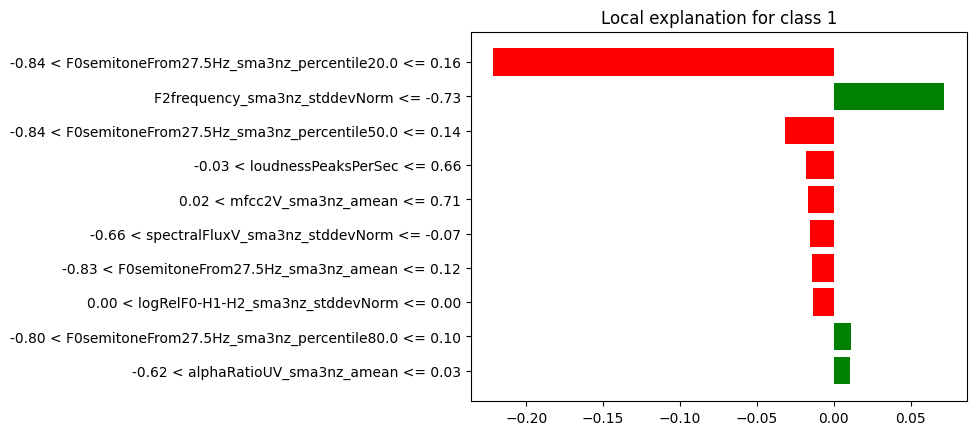

In [78]:
out = explanation.as_pyplot_figure()

In [79]:
df_exp = pd.DataFrame(explanation.as_list(), columns=['feature', 'value'])
df_exp

,feature,value
0,-0.84 < F0semitoneFrom27.5Hz_sma3nz_percentile...,-0.221476
1,F2frequency_sma3nz_stddevNorm <= -0.73,0.071796
2,-0.84 < F0semitoneFrom27.5Hz_sma3nz_percentile...,-0.031417
3,-0.03 < loudnessPeaksPerSec <= 0.66,-0.017802
4,0.02 < mfcc2V_sma3nz_amean <= 0.71,-0.016903
5,-0.66 < spectralFluxV_sma3nz_stddevNorm <= -0.07,-0.015207
6,-0.83 < F0semitoneFrom27.5Hz_sma3nz_amean <= 0.12,-0.014474
7,0.00 < logRelF0-H1-H2_sma3nz_stddevNorm <= 0.00,-0.013316
8,-0.80 < F0semitoneFrom27.5Hz_sma3nz_percentile...,0.011115
9,-0.62 < alphaRatioUV_sma3nz_amean <= 0.03,0.010445


In [80]:
out = explanation.show_in_notebook(show_table=True, show_all=False)

In [81]:
explanation.as_list()

[('-0.84 < F0semitoneFrom27.5Hz_sma3nz_percentile20.0 <= 0.16',
  -0.22147619994751622),
 ('F2frequency_sma3nz_stddevNorm <= -0.73', 0.07179641352871059),
 ('-0.84 < F0semitoneFrom27.5Hz_sma3nz_percentile50.0 <= 0.14',
  -0.03141668475183029),
 ('-0.03 < loudnessPeaksPerSec <= 0.66', -0.017802139587927267),
 ('0.02 < mfcc2V_sma3nz_amean <= 0.71', -0.016902642329361662),
 ('-0.66 < spectralFluxV_sma3nz_stddevNorm <= -0.07', -0.015207197667770058),
 ('-0.83 < F0semitoneFrom27.5Hz_sma3nz_amean <= 0.12', -0.014474074177374452),
 ('0.00 < logRelF0-H1-H2_sma3nz_stddevNorm <= 0.00', -0.01331569431050731),
 ('-0.80 < F0semitoneFrom27.5Hz_sma3nz_percentile80.0 <= 0.10',
  0.01111487195376654),
 ('-0.62 < alphaRatioUV_sma3nz_amean <= 0.03', 0.010444648169482654)]

In [82]:
features = [
    'F0semitoneFrom27.5Hz_sma3nz_percentile20.0',
    'F2frequency_sma3nz_stddevNorm',
    'F0semitoneFrom27.5Hz_sma3nz_percentile50.0',
    'loudnessPeaksPerSec',
    'mfcc2V_sma3nz_amean',
    'spectralFluxV_sma3nz_stddevNorm',
    'F0semitoneFrom27.5Hz_sma3nz_amean',
    'logRelF0-H1-H2_sma3nz_stddevNorm',
    'F0semitoneFrom27.5Hz_sma3nz_percentile80.0',
    'alphaRatioUV_sma3nz_amean',
    'y'
]
get_explained_data(explained_data, 203077, features)

F0semitoneFrom27.5Hz_sma3nz_percentile20.0   -0.299467
F2frequency_sma3nz_stddevNorm                -1.012471
F0semitoneFrom27.5Hz_sma3nz_percentile50.0    -0.28053
loudnessPeaksPerSec                           0.120871
mfcc2V_sma3nz_amean                           0.625247
spectralFluxV_sma3nz_stddevNorm              -0.549398
F0semitoneFrom27.5Hz_sma3nz_amean            -0.365997
logRelF0-H1-H2_sma3nz_stddevNorm              0.003074
F0semitoneFrom27.5Hz_sma3nz_percentile80.0   -0.436722
alphaRatioUV_sma3nz_amean                    -0.133889
y                                                    0
Name: 203077, dtype: object

## Explicabilité BA10

In [83]:
explained_data = pd.read_csv('Step3/explainability_results/lime/BA10/explain_data.csv', index_col=0)
explained_data

,name,F0semitoneFrom27.5Hz_sma3nz_amean,F0semitoneFrom27.5Hz_sma3nz_stddevNorm,F0semitoneFrom27.5Hz_sma3nz_percentile20.0,F0semitoneFrom27.5Hz_sma3nz_percentile50.0,F0semitoneFrom27.5Hz_sma3nz_percentile80.0,F0semitoneFrom27.5Hz_sma3nz_pctlrange0-2,F0semitoneFrom27.5Hz_sma3nz_meanRisingSlope,F0semitoneFrom27.5Hz_sma3nz_stddevRisingSlope,F0semitoneFrom27.5Hz_sma3nz_meanFallingSlope,...,slopeUV500-1500_sma3nz_amean,spectralFluxUV_sma3nz_amean,loudnessPeaksPerSec,VoicedSegmentsPerSec,MeanVoicedSegmentLengthSec,StddevVoicedSegmentLengthSec,MeanUnvoicedSegmentLength,StddevUnvoicedSegmentLength,equivalentSoundLevel_dBp,y
10819,/local_disk/arges/jduret/corpus/voxceleb2/wav/...,0.427331,-0.396053,0.363010,0.357640,0.432005,0.203886,0.133715,0.047627,-0.497833,...,0.645662,-0.719450,-1.135973,-0.368731,0.065772,-0.055068,0.031263,0.357133,-0.191276,0
8087,/local_disk/arges/jduret/corpus/voxceleb2/wav/...,0.377521,-0.611750,0.412673,0.285139,0.314517,-0.149138,-0.631379,-0.424206,-0.293321,...,-0.329522,-0.684457,-2.347927,-0.380475,0.315552,-0.083713,-0.081150,-0.452029,-0.040017,0


In [84]:
path = 'Step3/explainability_results/lime/BA10/8087/explanation.pkl'
explanation = load_data(path)

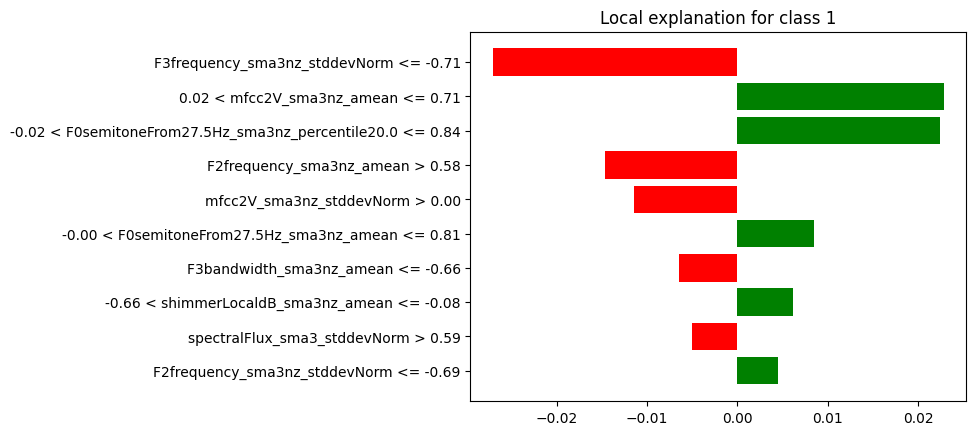

In [85]:
out = explanation.as_pyplot_figure()

In [86]:
df_exp = pd.DataFrame(explanation.as_list(), columns=['feature', 'value'])
df_exp

,feature,value
0,F3frequency_sma3nz_stddevNorm <= -0.71,-0.027019
1,0.02 < mfcc2V_sma3nz_amean <= 0.71,0.022832
2,-0.02 < F0semitoneFrom27.5Hz_sma3nz_percentile...,0.022433
3,F2frequency_sma3nz_amean > 0.58,-0.014635
4,mfcc2V_sma3nz_stddevNorm > 0.00,-0.011473
5,-0.00 < F0semitoneFrom27.5Hz_sma3nz_amean <= 0.81,0.008452
6,F3bandwidth_sma3nz_amean <= -0.66,-0.006512
7,-0.66 < shimmerLocaldB_sma3nz_amean <= -0.08,0.006099
8,spectralFlux_sma3_stddevNorm > 0.59,-0.005005
9,F2frequency_sma3nz_stddevNorm <= -0.69,0.004440


In [87]:
out = explanation.show_in_notebook(show_table=True, show_all=False)

In [88]:
explanation.as_list()

[('F3frequency_sma3nz_stddevNorm <= -0.71', -0.027018645862866005),
 ('0.02 < mfcc2V_sma3nz_amean <= 0.71', 0.02283177421835897),
 ('-0.02 < F0semitoneFrom27.5Hz_sma3nz_percentile20.0 <= 0.84',
  0.022433183329092856),
 ('F2frequency_sma3nz_amean > 0.58', -0.014635048528285987),
 ('mfcc2V_sma3nz_stddevNorm > 0.00', -0.011472986820102775),
 ('-0.00 < F0semitoneFrom27.5Hz_sma3nz_amean <= 0.81', 0.008452117919862667),
 ('F3bandwidth_sma3nz_amean <= -0.66', -0.006512056881418486),
 ('-0.66 < shimmerLocaldB_sma3nz_amean <= -0.08', 0.0060993806226519644),
 ('spectralFlux_sma3_stddevNorm > 0.59', -0.005005257800823473),
 ('F2frequency_sma3nz_stddevNorm <= -0.69', 0.004439552807527926)]

In [89]:
features = [
    'y'
]
get_explained_data(explained_data, 8087, features)

y    0
Name: 8087, dtype: object

In [90]:
path = 'Step3/explainability_results/lime/BA10/10819/explanation.pkl'
explanation = load_data(path)


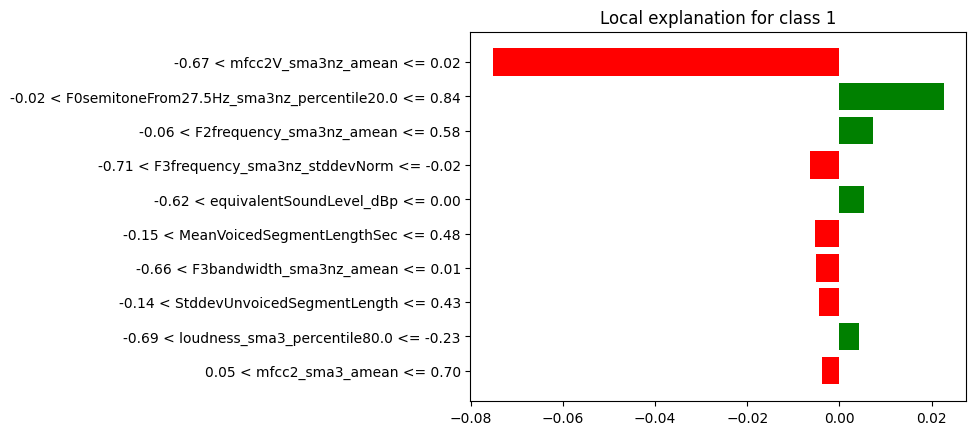

In [91]:
out = explanation.as_pyplot_figure()


In [92]:
df_exp = pd.DataFrame(explanation.as_list(), columns=['feature', 'value'])
df_exp


,feature,value
0,-0.67 < mfcc2V_sma3nz_amean <= 0.02,-0.075122
1,-0.02 < F0semitoneFrom27.5Hz_sma3nz_percentile...,0.022658
2,-0.06 < F2frequency_sma3nz_amean <= 0.58,0.007346
3,-0.71 < F3frequency_sma3nz_stddevNorm <= -0.02,-0.006404
4,-0.62 < equivalentSoundLevel_dBp <= 0.00,0.005386
5,-0.15 < MeanVoicedSegmentLengthSec <= 0.48,-0.005361
6,-0.66 < F3bandwidth_sma3nz_amean <= 0.01,-0.004980
7,-0.14 < StddevUnvoicedSegmentLength <= 0.43,-0.004336
8,-0.69 < loudness_sma3_percentile80.0 <= -0.23,0.004177
9,0.05 < mfcc2_sma3_amean <= 0.70,-0.003760


In [93]:
out = explanation.show_in_notebook(show_table=True, show_all=False)


In [94]:
features = [
    'y'
]
get_explained_data(explained_data, 10819, features)

y    0
Name: 10819, dtype: object